In [1]:
from coremdlr.facies.viz import CorePlotter
from coremdlr.facies.datasets import FaciesDataset

%matplotlib inline

Using TensorFlow backend.


In [2]:
fdset = FaciesDataset(["205-21b-3", "204-20-6a", "204-20-1Z"],
                    test_wells=["204-19-6"],
                    features=["image", "pseudoGR", "logs"])

fdset.load_or_generate_data()

Loading Well:  205-21b-3  from  /home/administrator/Dropbox/core_data/facies/train_data


/home/administrator/code/python/coremdlr/coremdlr/facies/datasets/utils.py:72: RuntimeWarning: Mean of empty slice
  output_features.append(np.nanmean(img, axis=1))
/home/administrator/code/python/coremdlr/coremdlr/facies/datasets/utils.py:76: RuntimeWarning: Degrees of freedom <= 0 for slice.
  output_features.append(np.nanvar(img, axis=1))


Extracted pGR features:  ['Umean', 'Rmean', 'Gmean', 'Bmean', 'Uvar', 'Rvar', 'Gvar', 'Bvar']


Header section Parameter regexp=~P was not found.


Adding NaN log:  SP
Adding NaN log:  DTS
Feature shapes:  [('depth', (3842,)), ('top', (3842,)), ('base', (3842,)), ('image', (3842, 32, 600, 3)), ('pseudoGR', (3842, 32, 8)), ('logs', (3842, 11))]
Loading Well:  204-20-6a  from  /home/administrator/Dropbox/core_data/facies/train_data
Extracted pGR features:  ['Umean', 'Rmean', 'Gmean', 'Bmean', 'Uvar', 'Rvar', 'Gvar', 'Bvar']


Header section Parameter regexp=~P was not found.


Adding NaN log:  SP
Adding NaN log:  DTS1
Adding NaN log:  DTS2
Feature shapes:  [('depth', (3873,)), ('top', (3873,)), ('base', (3873,)), ('image', (3873, 32, 600, 3)), ('pseudoGR', (3873, 32, 8)), ('logs', (3873, 11))]
Loading Well:  204-20-1Z  from  /home/administrator/Dropbox/core_data/facies/train_data
Extracted pGR features:  ['Umean', 'Rmean', 'Gmean', 'Bmean', 'Uvar', 'Rvar', 'Gvar', 'Bvar']


Header section Parameter regexp=~P was not found.


Adding NaN log:  SP
Adding NaN log:  DTS1
Adding NaN log:  DTS2
Feature shapes:  [('depth', (1917,)), ('top', (1917,)), ('base', (1917,)), ('image', (1917, 32, 600, 3)), ('pseudoGR', (1917, 32, 8)), ('logs', (1917, 11))]


/home/administrator/anaconda3/envs/core-dev/lib/python3.6/site-packages/sklearn/preprocessing/_function_transformer.py:98: FutureWarning: The default validate=True will be replaced by validate=False in 0.22.
  "validate=False in 0.22.", FutureWarning)


Loading Well:  204-19-6  from  /home/administrator/Dropbox/core_data/facies/train_data


/home/administrator/code/python/coremdlr/coremdlr/facies/datasets/utils.py:72: RuntimeWarning: Mean of empty slice
  output_features.append(np.nanmean(img, axis=1))
/home/administrator/code/python/coremdlr/coremdlr/facies/datasets/utils.py:76: RuntimeWarning: Degrees of freedom <= 0 for slice.
  output_features.append(np.nanvar(img, axis=1))


Extracted pGR features:  ['Umean', 'Rmean', 'Gmean', 'Bmean', 'Uvar', 'Rvar', 'Gvar', 'Bvar']


Header section Parameter regexp=~P was not found.


Adding NaN log:  DTS
Feature shapes:  [('depth', (1884,)), ('top', (1884,)), ('base', (1884,)), ('image', (1884, 32, 600, 3)), ('pseudoGR', (1884, 32, 8)), ('logs', (1884, 11))]


/home/administrator/anaconda3/envs/core-dev/lib/python3.6/site-packages/sklearn/preprocessing/_function_transformer.py:98: FutureWarning: The default validate=True will be replaced by validate=False in 0.22.
  "validate=False in 0.22.", FutureWarning)


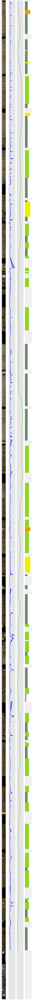

In [3]:
cplotter = CorePlotter(figsize=(20, 650))

well = fdset.wells[0]
well_X, well_y = fdset.get_well_data(well.well_name, include_meta=True)

cplotter.plot_image(well._image  / 255.0, depths=well._depth)

cplotter.plot_log(well_X['depth'], well_X['pseudoGR'].mean(axis=-1), fmt='--', color='blue', lw=2)

cplotter.plot_log(well_X['depth'], well_X['logs'][:, 0], existing_ax=True, color='green', lw=5)

cplotter.plot_strip(well.make_striplog(), name='Labels')

No axis with name: Logs. Returning None.
Changing ax Image geom to: (1, 2, 1)
Changing ax Image geom to: (1, 3, 1)
Changing ax Logs geom to: (1, 3, 2)
Changing ax Image geom to: (1, 4, 1)
Changing ax Logs geom to: (1, 4, 2)
Changing ax Logs geom to: (1, 4, 3)


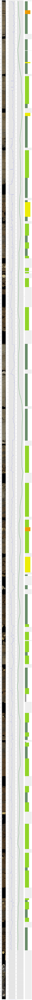

In [19]:
cplotter = CorePlotter(figsize=(20, 650))

well = fdset.wells[0]
well_X, well_y = fdset.get_well_data(well.well_name, include_meta=True)

cplotter.plot_image(well._image  / 255.0, depths=well._depth)

cplotter.plot_log(well_X['depth'], well_X['pseudoGR'].mean(axis=-1), fmt='--', color='blue', lw=2)

cplotter.plot_log(well_X['depth'], well_X['logs'][:, 0], existing_ax=False, color='green', lw=5)

cplotter.plot_strip(well.make_striplog(), name='Labels')

In [6]:
print(fdset)


Facies Patch Dataset providing ['logs', 'image', 'pseudoGR']
Classes: ['sandstone', 'clay-prone sandstone', 'sandy mudstone', 'mudstone']
Wells: ['205-21b-3', '204-19-6']
Test Wells: ['204-20-6a']



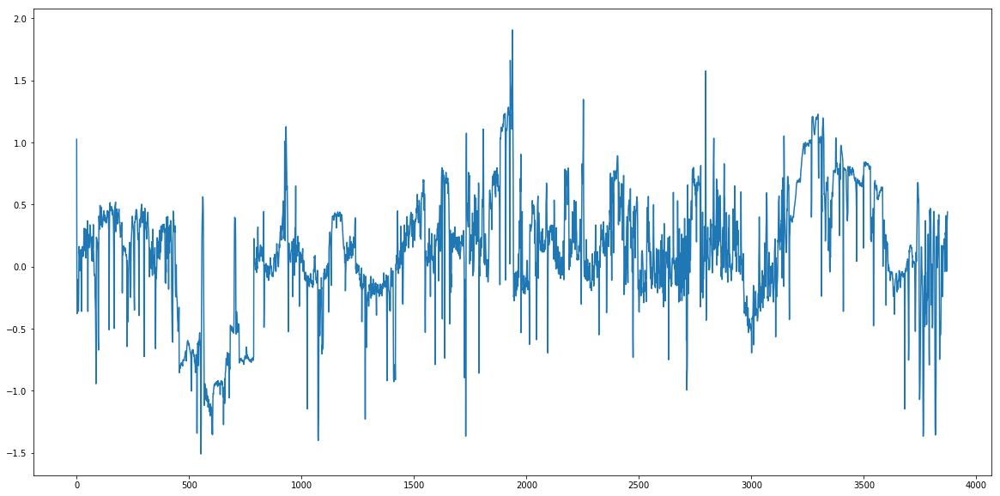

In [6]:
import matplotlib.pyplot as plt

pGR = fdset.X_test['pseudoGR'].mean(-1)
plt.figure(figsize=(20,10))
plt.plot(np.arange(pGR.size), pGR)

In [7]:
{f : fdset.X_train[f].shape for f in fdset.features}

{'image': (5726, 32, 600, 3), 'logs': (5726, 11), 'pseudoGR': (5726, 32)}

In [8]:
{f : fdset.X_test[f].shape for f in fdset.features}

{'image': (3873, 32, 600, 3), 'logs': (3873, 11), 'pseudoGR': (3873, 32)}

In [16]:
import numpy

def smooth(x,window_len=11,window='hanning'):
    """smooth the data using a window with requested size.
    
    This method is based on the convolution of a scaled window with the signal.
    The signal is prepared by introducing reflected copies of the signal 
    (with the window size) in both ends so that transient parts are minimized
    in the begining and end part of the output signal.
    
    input:
        x: the input signal 
        window_len: the dimension of the smoothing window; should be an odd integer
        window: the type of window from 'flat', 'hanning', 'hamming', 'bartlett', 'blackman'
            flat window will produce a moving average smoothing.

    output:
        the smoothed signal
        
    example:

    t=linspace(-2,2,0.1)
    x=sin(t)+randn(len(t))*0.1
    y=smooth(x)
    
    see also: 
    
    numpy.hanning, numpy.hamming, numpy.bartlett, numpy.blackman, numpy.convolve
    scipy.signal.lfilter
 
    TODO: the window parameter could be the window itself if an array instead of a string
    NOTE: length(output) != length(input), to correct this: return y[(window_len/2-1):-(window_len/2)] instead of just y.
    """

    if x.ndim != 1:
        raise ValueError("smooth only accepts 1 dimension arrays.")

    if x.size < window_len:
        raise ValueError("Input vector needs to be bigger than window size.")


    if window_len<3:
        return x

    if not window in ['flat', 'hanning', 'hamming', 'bartlett', 'blackman']:
        raise ValueError("Window is on of 'flat', 'hanning', 'hamming', 'bartlett', 'blackman'")


    s=numpy.r_[x[window_len-1:0:-1],x,x[-2:-window_len-1:-1]]
    #print(len(s))
    if window == 'flat': #moving average
        w=numpy.ones(window_len,'d')
    else:
        w=eval('numpy.'+window+'(window_len)')

    y=numpy.convolve(w/w.sum(),s,mode='valid')
    return y

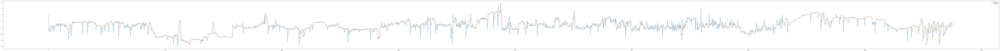

In [25]:
pGR_smooth = smooth(pGR, window_len=10)
plt.figure(figsize=(200,10))
plt.plot(np.arange(pGR.size), pGR, label='original')
plt.plot(np.arange(pGR_smooth.size), pGR_smooth, label='smoothed')
plt.legend()

In [27]:
pGR.size, pGR_smooth.size

(3873, 3882)

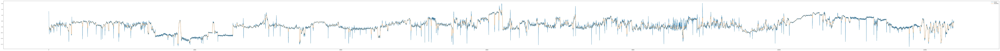

In [33]:
from scipy.signal import medfilt

pGR_smooth = medfilt(pGR, kernel_size=99)
plt.figure(figsize=(200,10))
plt.plot(np.arange(pGR.size), pGR, label='original')
plt.plot(np.arange(pGR_smooth.size), pGR_smooth, label='smoothed')
plt.legend()

In [46]:
[1,2][0:2]

[1, 2]

In [25]:
np.argmin(np.array([3, 1, -np.inf]))

2

In [28]:
for p in zip(np.random.rand(10,), np.random.rand(10,)):
    print(p)

(0.11669984540408551, 0.5810828857706065)
(0.584484502451161, 0.5151354477415271)
(0.775670675785479, 0.5065955024099269)
(0.2457806552922287, 0.7592275504326638)
(0.4726394387645134, 0.8843053395590311)
(0.6407339225547953, 0.5651225731840813)
(0.47301773109223055, 0.4354324005690706)
(0.981978056314849, 0.5158099541805868)
(0.8363027348347138, 0.6077291338342063)
(0.08659641243773586, 0.5956935126563313)


In [31]:
np.insert(np.random.rand(10,), (0, 10), np.inf)

array([       inf, 0.01716643, 0.31622594, 0.43275617, 0.73196742,
       0.68209871, 0.14354215, 0.03660986, 0.91309567, 0.56774765,
       0.96478462,        inf])

In [7]:
import pandas as pd

In [8]:
df = pd.DataFrame()
type(df)

pandas.core.frame.DataFrame

In [9]:
import numpy as np

In [11]:
y = np.random.rand(20)*3

In [12]:
y

array([0.49869077, 1.98010251, 1.71597011, 0.01487438, 1.96850064,
       2.51762247, 1.74682618, 1.48385313, 0.35649651, 1.07066162,
       2.45247106, 0.57746393, 0.11264595, 2.28410711, 1.13517924,
       2.72465185, 2.49523759, 2.26202615, 1.79448285, 2.34260582])

In [16]:
k = 3

(k+1)*y/k - 0.5

array([ 0.16492103,  2.14013667,  1.78796014, -0.48016749,  2.12466752,
        2.85682996,  1.82910157,  1.47847084, -0.02467132,  0.92754883,
        2.76996142,  0.2699519 , -0.3498054 ,  2.54547614,  1.01357232,
        3.13286914,  2.82698345,  2.51603487,  1.8926438 ,  2.62347443])

In [17]:
(k+1)*3/k - 0.5

3.5